# Wykrywanie naczyń krwionośnych dna oka
## Autorzy:
### Maria Mikołajczak 141282
### Michał Mędzin 141279

Bibilografia
* Gour, N., & Khanna, P. (2017, December). Blood vessel segmentation using hybrid median filtering and morphological transformation. In 2017 13th International Conference on Signal-Image Technology & Internet-Based Systems (SITIS) (pp. 151-157). IEEE.
* Khan, K. B., Khaliq, A. A., Jalil, A., & Shahid, M. (2018). A robust technique based on VLM and Frangi filter for retinal vessel extraction and denoising. PloS one, 13(2), e0192203.

In [1]:
%matplotlib inline

import os
import re

import cv2
import numpy as np
from matplotlib import pylab as plt
from pylab import *
from skimage import io, filters

In [2]:
plt.rcParams['ytick.left']= False
plt.rcParams['ytick.right'] = False
plt.rcParams['ytick.labelleft'] = False
plt.rcParams['xtick.bottom'] = False
plt.rcParams['xtick.labelbottom'] = False
plt.rcParams["figure.figsize"] = (12,8)

## Załadowanie zdjęć

In [3]:
dir_images = 'images_HRF/images'
raw_images = os.listdir(dir_images)

dir_manuals = 'images_HRF/manual1'
manuals = os.listdir(dir_manuals)

## Wstępna obróbka (preprocessing)

### Wczytanie przykładowego zdjęcia

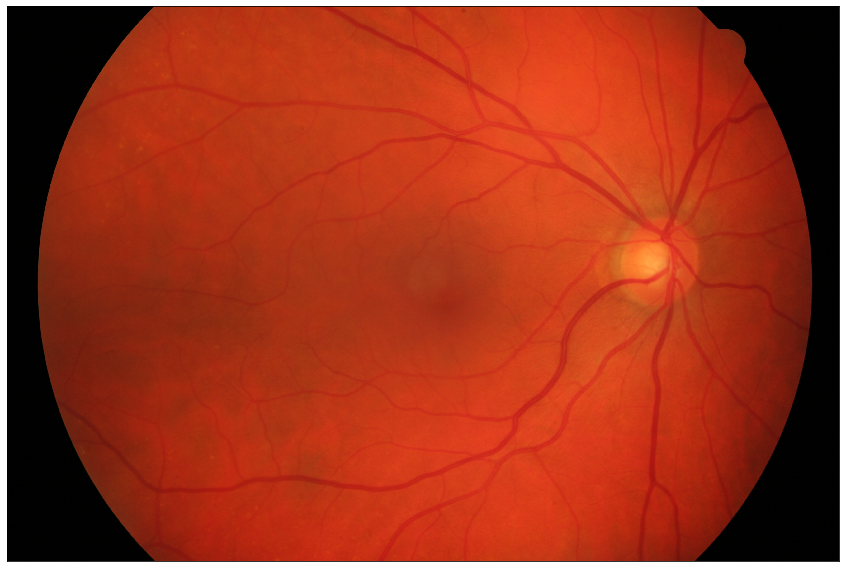

In [4]:
img = cv2.imread(os.path.join(dir_images, raw_images[13]))
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
io.imshow(img)

### RGB Split

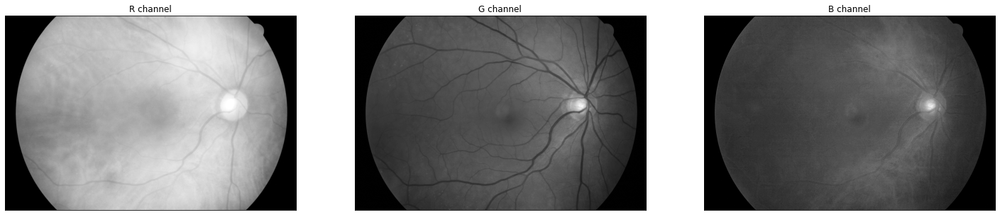

In [20]:
r_image, g_image, b_image = cv2.split(img)

fig, (ax1, ax2, ax3) = plt.subplots(1,3)
fig.set_size_inches(25, 20)

ax1.imshow(r_image, cmap='gray')
ax1.set_title('R channel')
ax2.imshow(g_image,cmap='gray')
ax2.set_title('G channel')
ax3.imshow(b_image,cmap='gray')
ax3.set_title('B channel')
plt.show()

### Green channel
#### CLAHE- Contrast Limited Adaptive Equalization

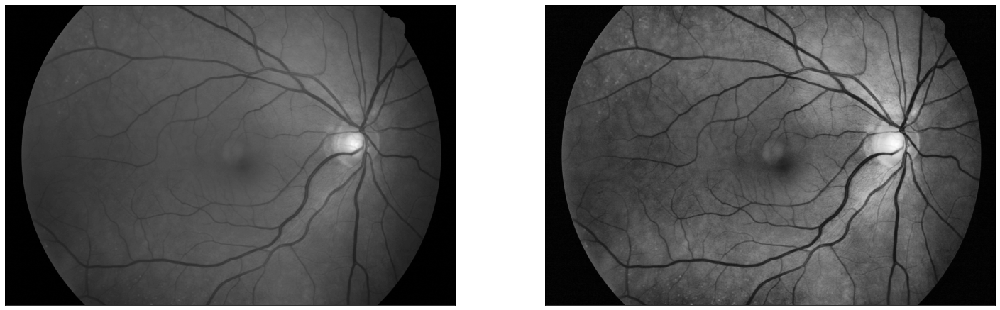

In [21]:
clahe = cv2.createCLAHE(clipLimit = 3.0, tileGridSize = (8,8))
green_contrast_enhanced = clahe.apply(g_image)

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches(25, 20)
ax1.imshow(g_image,cmap='gray')
ax2.imshow(green_contrast_enhanced,cmap='gray')

#### Unsharp Making and High Boost Filtering

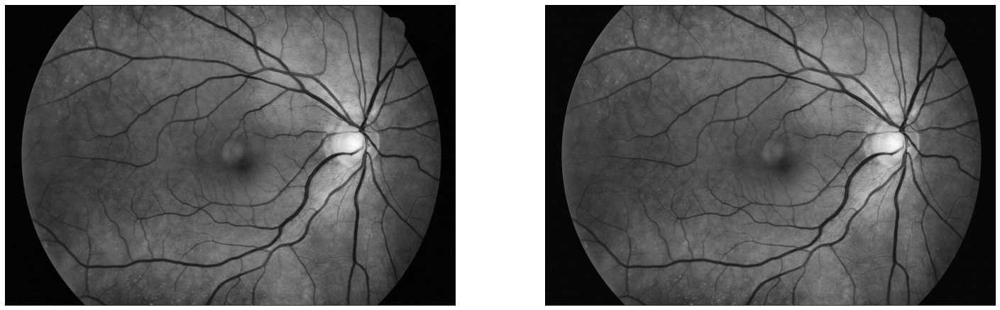

In [22]:
gauss = cv2.GaussianBlur(green_contrast_enhanced, (5,5), 0)
green_sharp = cv2.addWeighted(green_contrast_enhanced, 2, gauss, -1, 0)

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches(25, 20)
ax1.imshow(green_contrast_enhanced,cmap='gray')
ax2.imshow(green_sharp,cmap='gray')

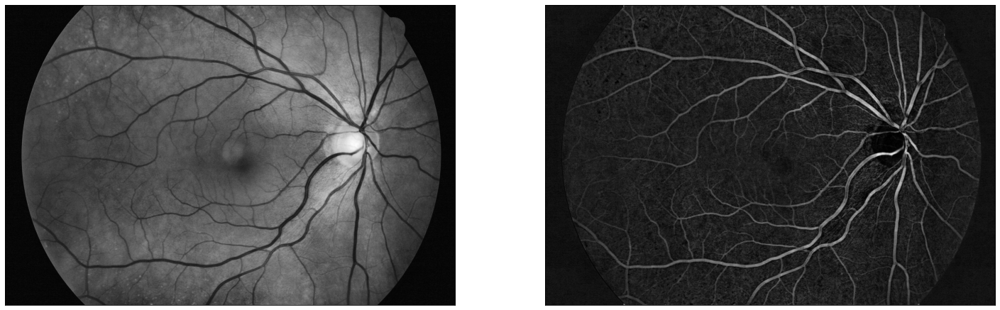

In [26]:
kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(30,30))

blackhat = cv2.morphologyEx(green_sharp, cv2.MORPH_BLACKHAT, kernel)

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches(25, 20)
ax1.imshow(green_sharp,cmap='gray')
ax2.imshow(blackhat,cmap='gray')

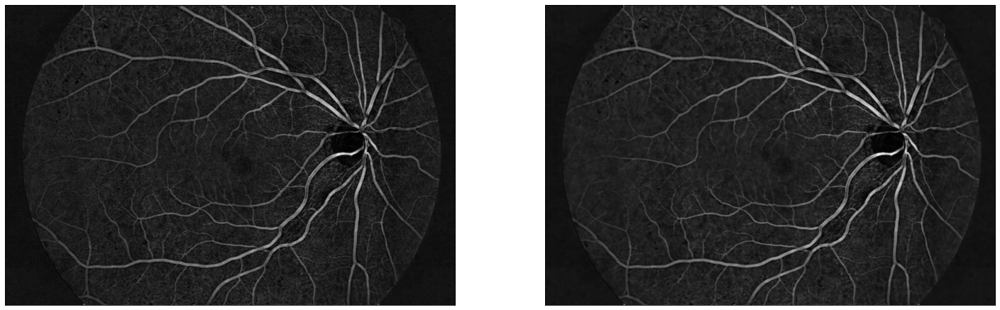

In [30]:
blackhat_blur =  cv2.fastNlMeansDenoising(blackhat, h=5)

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches(25, 20)
ax1.imshow(blackhat,cmap='gray')
ax2.imshow(blackhat_blur,cmap='gray')

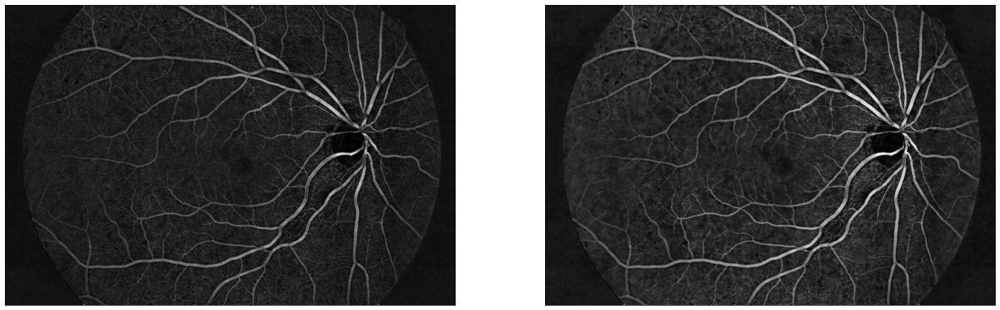

In [31]:
clahe = cv2.createCLAHE(clipLimit = 1.0, tileGridSize = (8,8))
blackhat_contrast_enhanced = cv2.medianBlur(clahe.apply(blackhat_blur),3)

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches(25, 20)
ax1.imshow(blackhat,cmap='gray')
ax2.imshow(blackhat_contrast_enhanced,cmap='gray')

#### Threshold

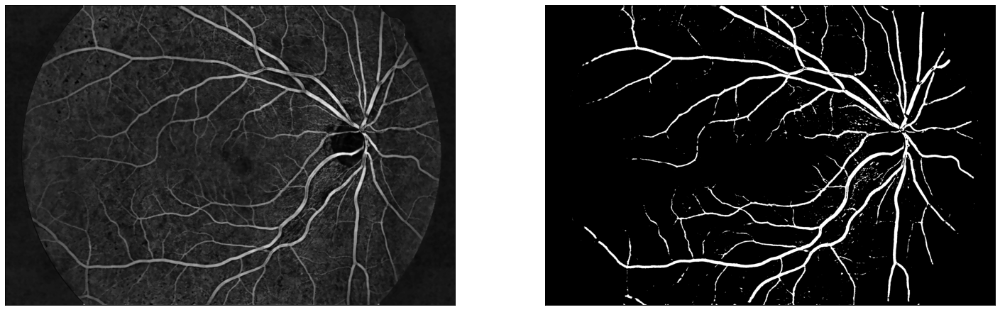

In [32]:
ret,green_threshed= cv2.threshold(blackhat_contrast_enhanced,20,255,cv2.THRESH_BINARY +cv2.THRESH_OTSU)

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches(25, 20)
ax2.imshow(green_threshed,cmap='gray')
ax1.imshow(blackhat_contrast_enhanced,cmap='gray')

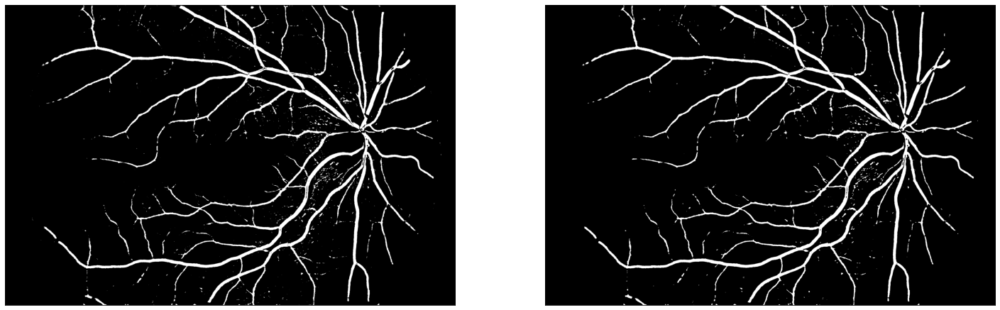

In [33]:
#final_blurred = cv2.GaussianBlur(green_threshed,(9,9), 0)
final_blurred = cv2.medianBlur(green_threshed, 5)

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches(25, 20)
ax1.imshow(green_threshed,cmap='gray')
ax2.imshow(final_blurred,cmap='gray')

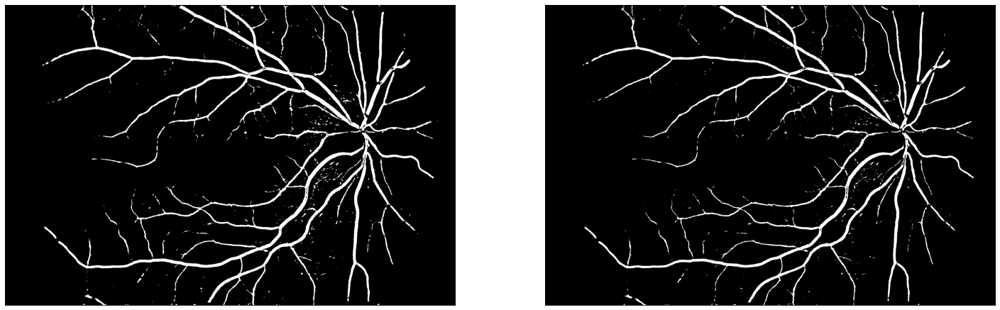

In [34]:
newfin = cv2.erode(final_blurred, cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3)), iterations=1)

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches(25, 20)
ax2.imshow(newfin,cmap='gray')
ax1.imshow(final_blurred,cmap='gray')

In [14]:
final_mask = newfin / 255

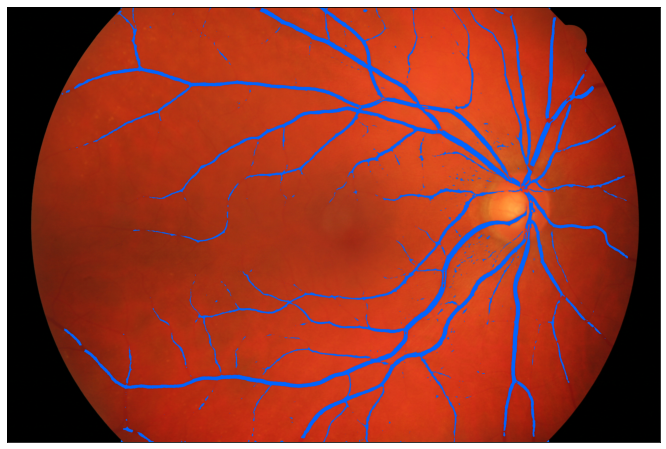

In [15]:
img_copy = img.copy()
img_copy[final_mask == 1] = [0, 100, 255]
plt.imshow(img_copy)

In [16]:
def get_retina_mask(img):
    r_image, g_image, b_image = cv2.split(img)
    ret,red_threshed= cv2.threshold(r_image,20,255,cv2.THRESH_BINARY)
    
    return cv2.bitwise_not(red_threshed)

    
    
def prep_img(img):
    r_image, g_image, b_image = cv2.split(img)
    
    clahe = cv2.createCLAHE(clipLimit = 3.0, tileGridSize = (8,8))
    green_contrast_enhanced = clahe.apply(g_image)

    gauss = cv2.GaussianBlur(green_contrast_enhanced, (5,5), 0)
    green_sharp = cv2.addWeighted(green_contrast_enhanced, 2, gauss, -1, 0)
    
    return green_sharp


def extract_blood_vessels(img, print_steps=False):

    prepared_img = prep_img(img)

    if print_steps:
        fig1, axs1 = plt.subplots(1,2)
        fig1.set_size_inches(15, 6)
        fig1.suptitle('Preprocessing', fontsize=16)
        axs1[0].imshow(img)
        axs1[1].imshow(prepared_img, cmap='gray')


    kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(30,30))
    blackhat = cv2.morphologyEx(prepared_img, cv2.MORPH_BLACKHAT, kernel)

    if print_steps:
        fig2, axs2 = plt.subplots(1,2)
        fig2.set_size_inches(15, 6)
        fig2.suptitle('Black Hat Transformation', fontsize=16)
        axs2[0].imshow(green_sharp, cmap='gray')
        axs2[1].imshow(blackhat, cmap='gray')

    blackhat_blur =  cv2.fastNlMeansDenoising(blackhat, h=5)
    clahe = cv2.createCLAHE(clipLimit = 1.0, tileGridSize = (8,8))
    blackhat_contrast_enhanced = cv2.medianBlur(clahe.apply(blackhat_blur), 3)
    ret,green_threshed= cv2ret,green_threshed= cv2.threshold(blackhat_contrast_enhanced,20,255,cv2.THRESH_BINARY +cv2.THRESH_OTSU)

    final_blurred = cv2.medianBlur(green_threshed, 5)
    newfin = cv2.erode(final_blurred, cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3)), iterations=1)

    if print_steps:
        fig3, axs3 = plt.subplots(1,2)
        fig3.set_size_inches(15, 6)
        fig3.suptitle('Postprocessing', fontsize=16)
        axs3[0].imshow(blackhat, cmap='gray')
        axs3[1].imshow(newfin, cmap='gray')


    plt.show()
    
    return newfin


def pad_mask(img, mask):
    if img.shape != mask.shape:
        rows_to_pad = (img.shape[0]-mask.shape[0]) //2
        cols_to_pad = (img.shape[1]-mask.shape[1]) //2 
        
        cols = np.zeros((mask.shape[0],cols_to_pad))
        mask = np.hstack(((np.hstack((cols, mask)), cols)))

        rows = np.zeros((rows_to_pad, mask.shape[1]))
        mask = np.vstack((np.vstack((rows, mask)), rows))
        
    return mask


def draw_mask(img, mask, color=[0,100,255]):
    if np.max(mask) > 1:
        mask = mask/255
        
    img_copy = img.copy()
    
    if len(img_copy.shape) < 3:
        img_copy = cv2.cvtColor(img_copy, cv2.COLOR_GRAY2BGR)
    
    padded_mask = pad_mask(img, mask)
        
    img_copy[padded_mask == 1] = color
    
    return img_copy

In [17]:
class ConfusionMatrix:
    def __init__(self, TP, FP, TN, FN):
        self.TP = TP
        self.FP = FP
        self.TN = TN
        self.FN = FN
        self.accuracy= (TP + TN)/(TP+TN+FN+FP)
        self.recall = TP/(TP+FN)
        self.precision = TP/(TP+FP)
        self.f1_score = 2 * (self.recall * self.precision)/ (self.recall + self.precision)
        self.G_mean = np.sqrt(self.recall * self.precision) 
        
    
    def __str__(self):
        return "True Positives: {} False Positives: {} \nFalse Negatives: {} True Negatives: {}\n\nAccuracy: {}\nPrecision: {}\nRecall: {}\nF1 Score: {}\nG-mean: {}".format(self.TP,self.FP,self.FN, self.TN, self.accuracy,
                            self.precision, self.recall, self.f1_score, self.G_mean)
    
    
def calculate_confusion_matrix(mask, mask_manual):
    
    if np.max(mask) > 1:
        mask = mask/ 255
        
    if np.max(mask_manual) > 1:
        mask_manual /= 255
        
    positives = np.nonzero(mask==1)
    negatives = np.where(mask != 1)

    total_predicted_positives = np.count_nonzero(mask==1)
    total_predicted_negatives = np.count_nonzero(mask!=1)

    true_positives = np.count_nonzero(mask_manual[positives]==1)
    false_positives = np.count_nonzero(mask_manual[positives]!=1)

    true_negatives = np.count_nonzero(mask_manual[negatives] ==0)
    false_negatives = np.count_nonzero(mask_manual[negatives] !=0)
    
    return ConfusionMatrix(true_positives, false_positives, true_negatives, false_negatives)

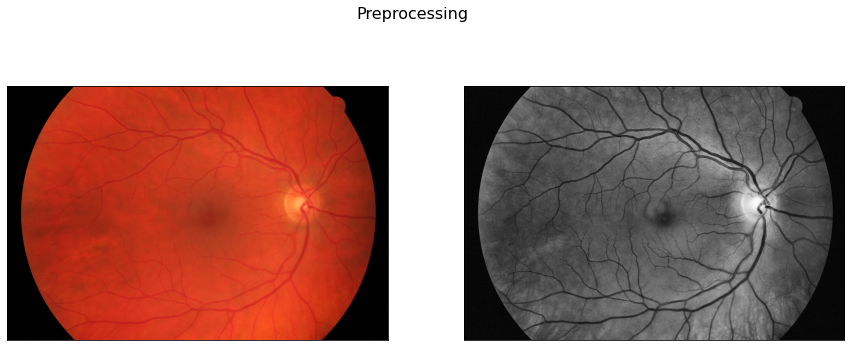

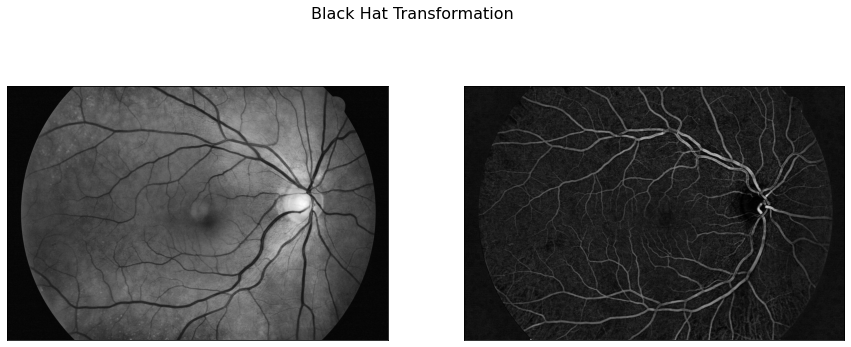

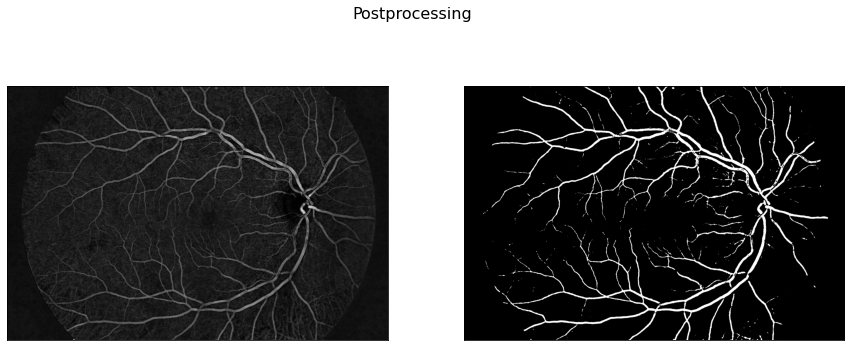

0.7216470184357379
395197
True Positives: 395197 False Positives: 158689 
False Negatives: 152435 True Negatives: 7479023

Accuracy: 0.9619901130606118
Precision: 0.7134988066136353
Recall: 0.7216470184357379
F1 Score: 0.7175497813018036
G-mean: 0.7175613468200381


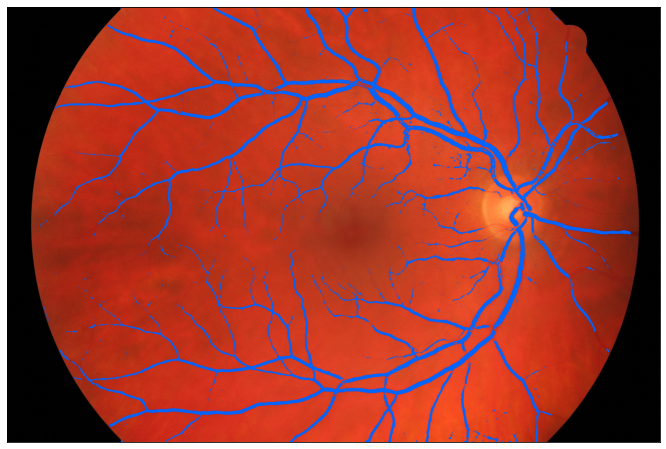

In [18]:
img = cv2.imread(os.path.join(dir_images, raw_images[1]))
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
img_manual = cv2.imread(os.path.join(dir_manuals, manuals[1]),0)/255

        
mask = extract_blood_vessels(img, True)
    
confusion_matrix = calculate_confusion_matrix(mask, img_manual)
print(confusion_matrix)
plt.imshow(draw_mask(img, mask))

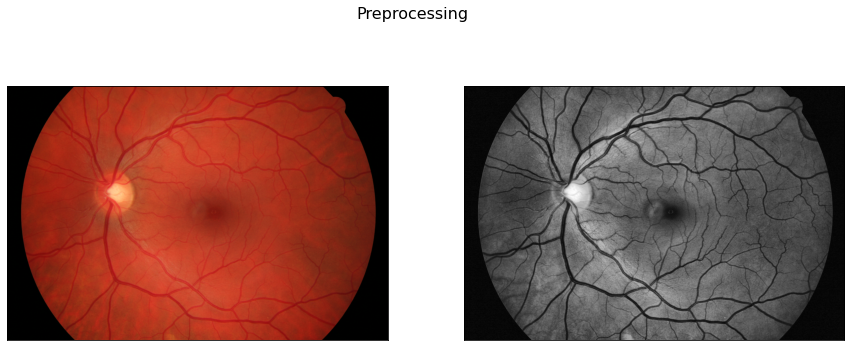

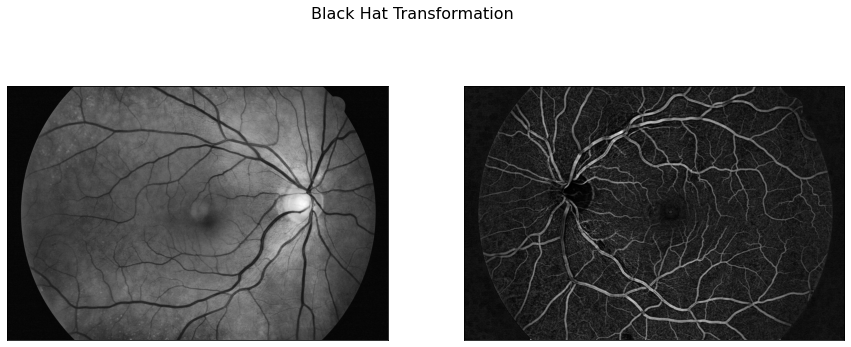

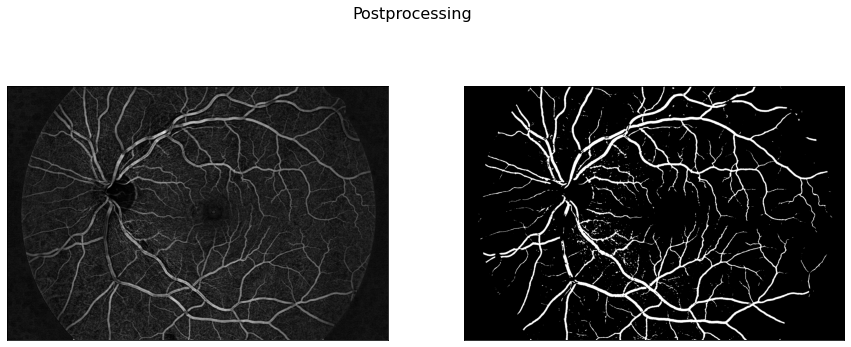

0.749694643067146
643861
True Positives: 643861 False Positives: 79961 
False Negatives: 214970 True Negatives: 7246552

Accuracy: 0.9639684049931194
Precision: 0.8895294699525574
Recall: 0.749694643067146
F1 Score: 0.8136477168400148
G-mean: 0.8166244415113902


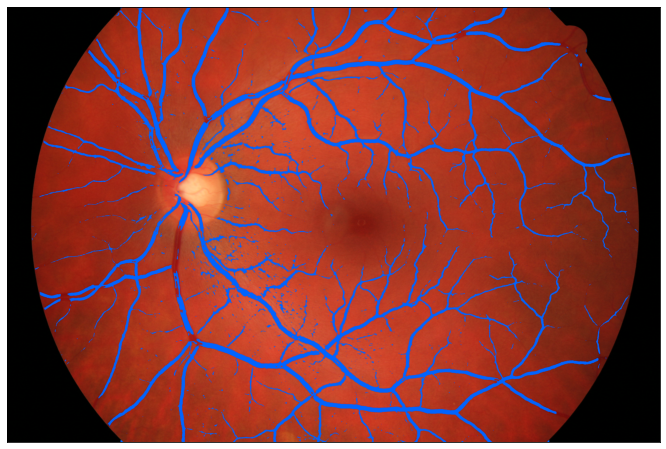

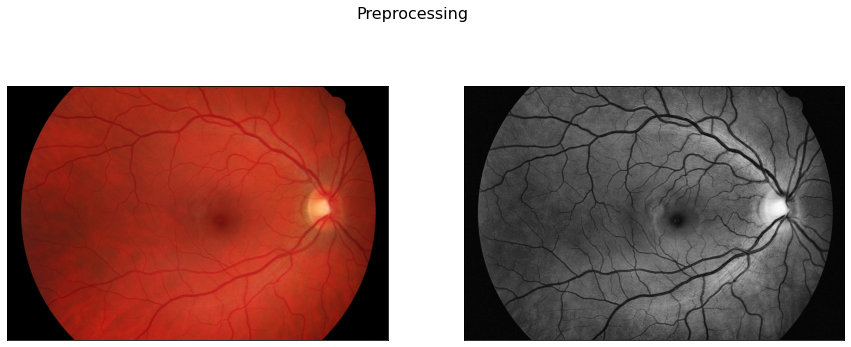

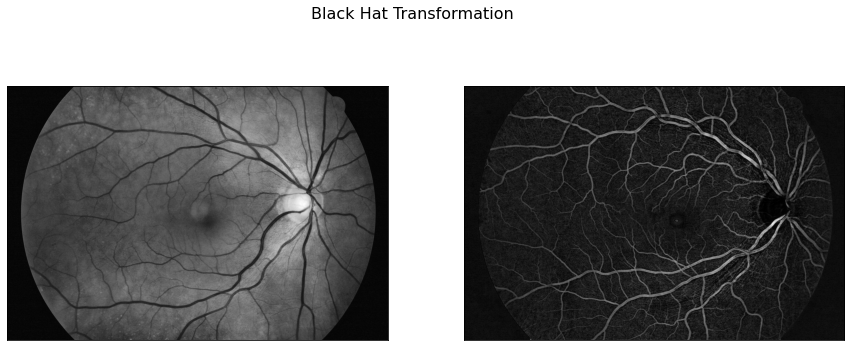

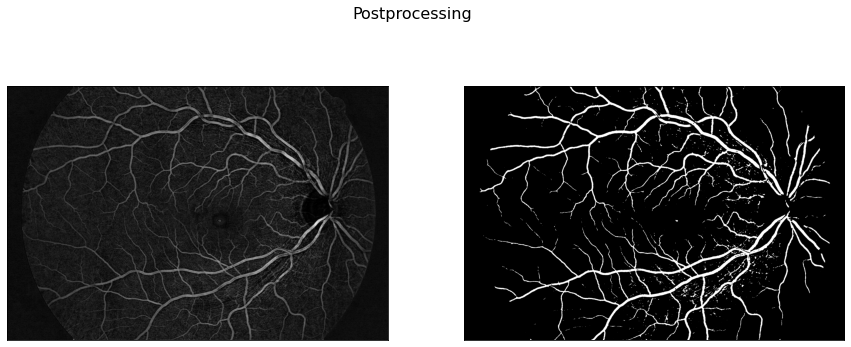

0.7523149176613255
575712
True Positives: 575712 False Positives: 92352 
False Negatives: 189542 True Negatives: 7327738

Accuracy: 0.9655611297460437
Precision: 0.8617617473774968
Recall: 0.7523149176613255
F1 Score: 0.8033276635052374
G-mean: 0.8051808604419143


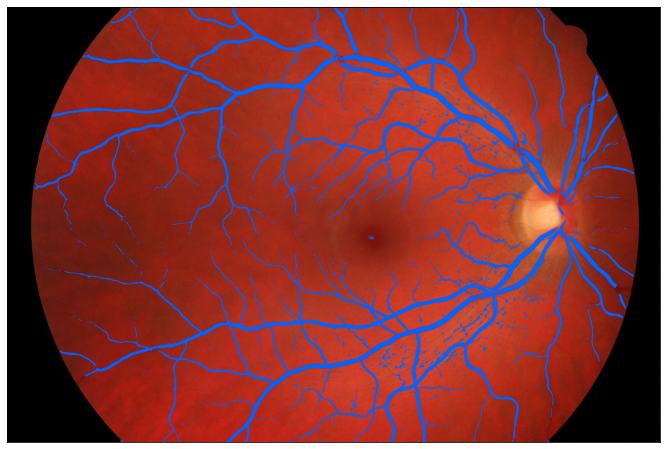

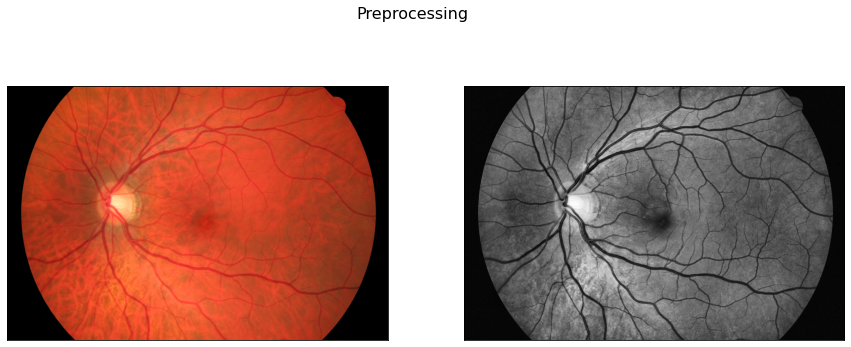

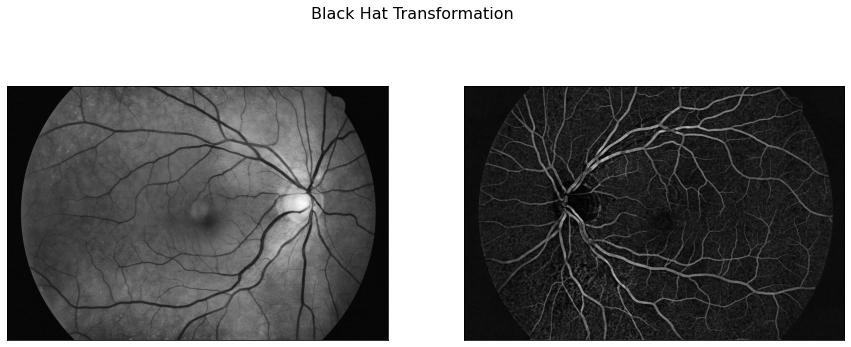

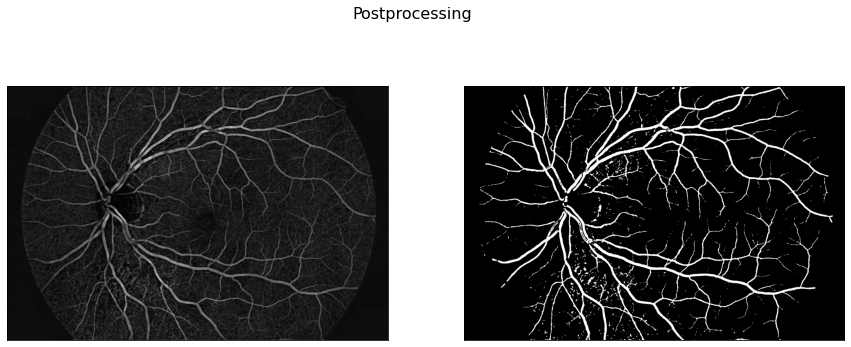

0.764617694863428
618146
True Positives: 618146 False Positives: 113551 
False Negatives: 190292 True Negatives: 7263355

Accuracy: 0.9628796297382248
Precision: 0.8448114451747103
Recall: 0.764617694863428
F1 Score: 0.8027166449694344
G-mean: 0.8037149866735895


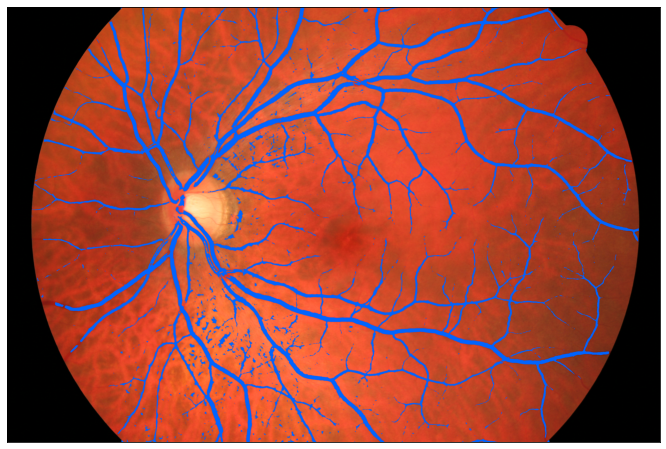

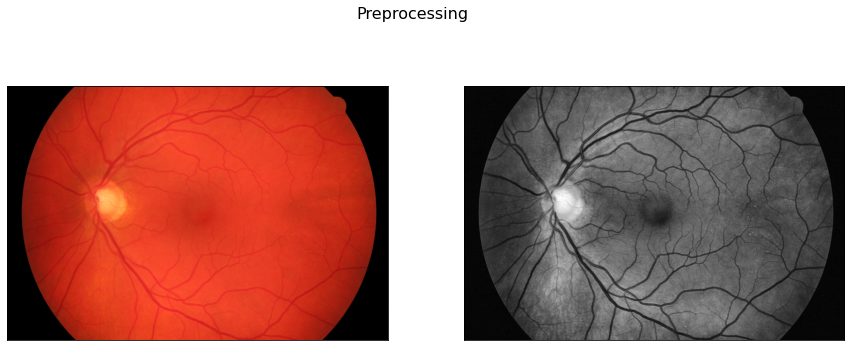

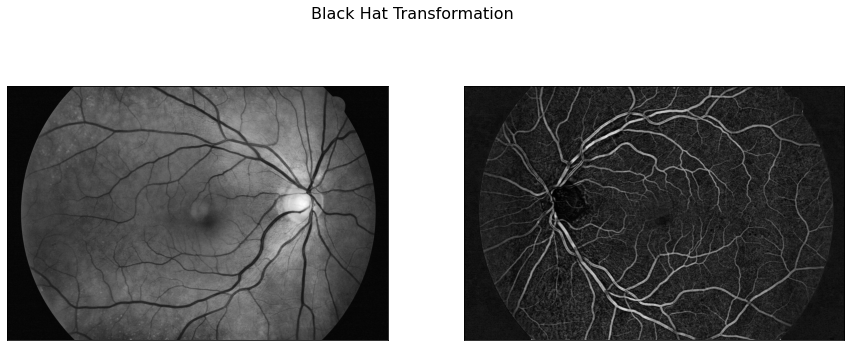

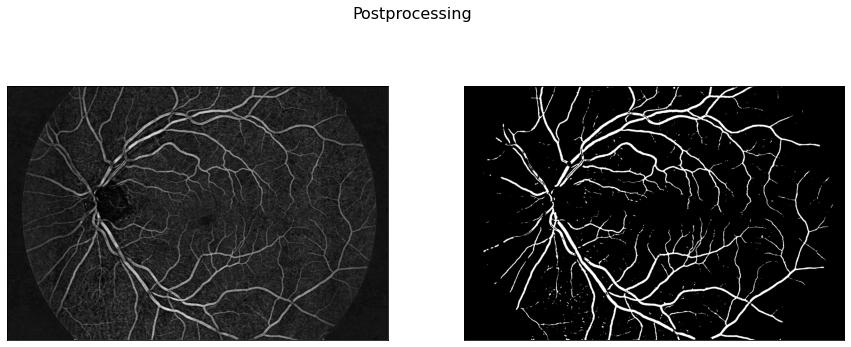

0.6967541232213644
572472
True Positives: 572472 False Positives: 54950 
False Negatives: 249155 True Negatives: 7308767

Accuracy: 0.9628476213095015
Precision: 0.9124193923706851
Recall: 0.6967541232213644
F1 Score: 0.7901347711499058
G-mean: 0.7973280214199215


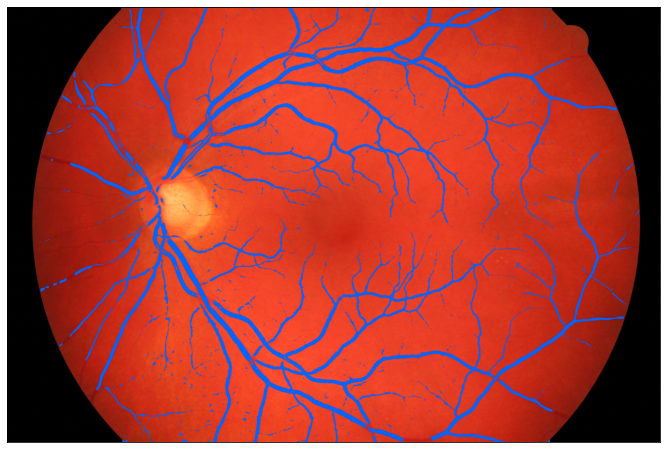

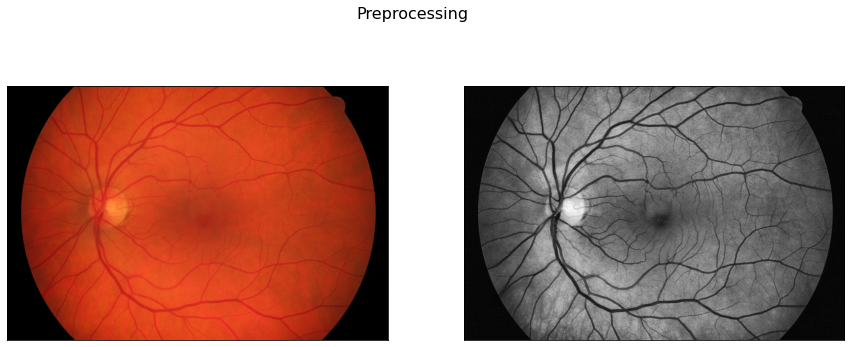

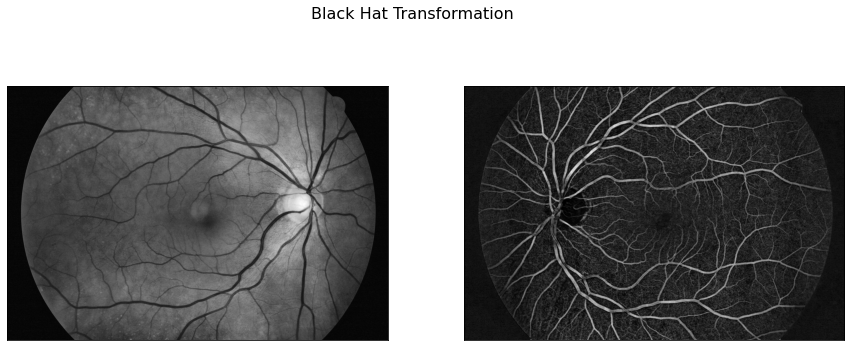

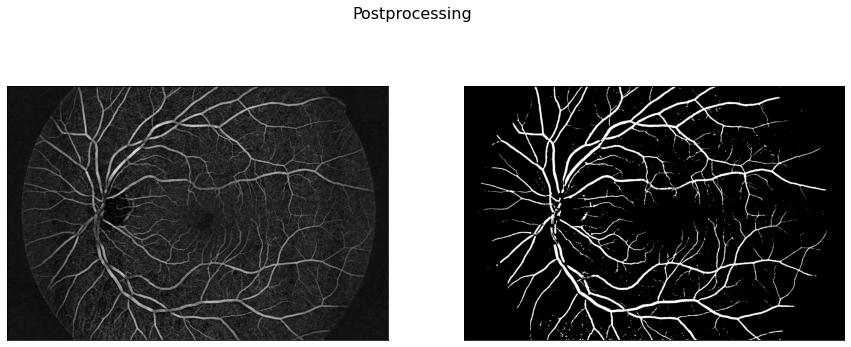

0.719936857580103
597454
True Positives: 597454 False Positives: 81441 
False Negatives: 232416 True Negatives: 7274033

Accuracy: 0.9616562236113717
Precision: 0.8800388867203323
Recall: 0.719936857580103
F1 Score: 0.7919775445480243
G-mean: 0.7959726318496938


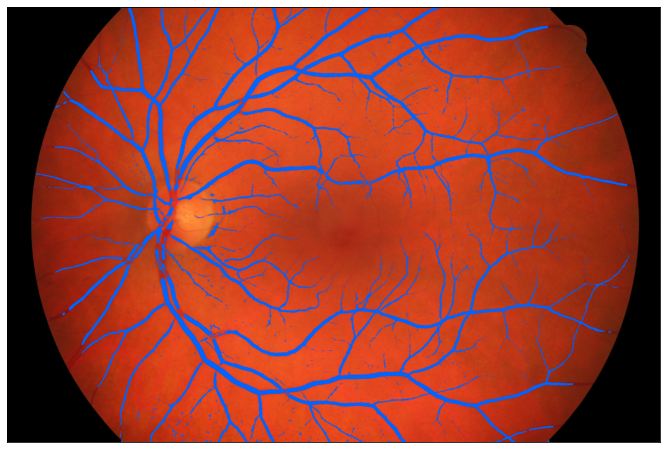

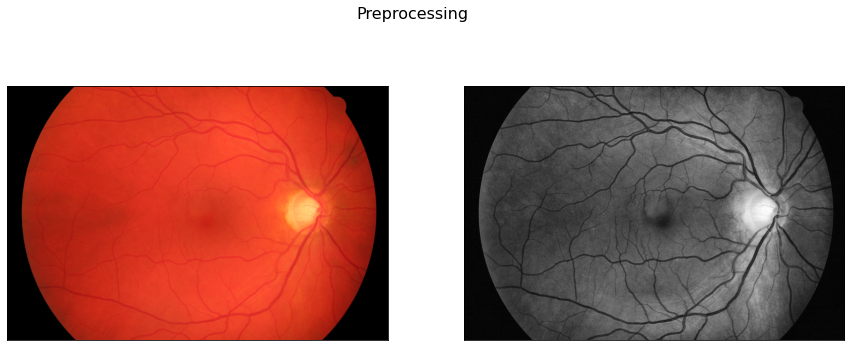

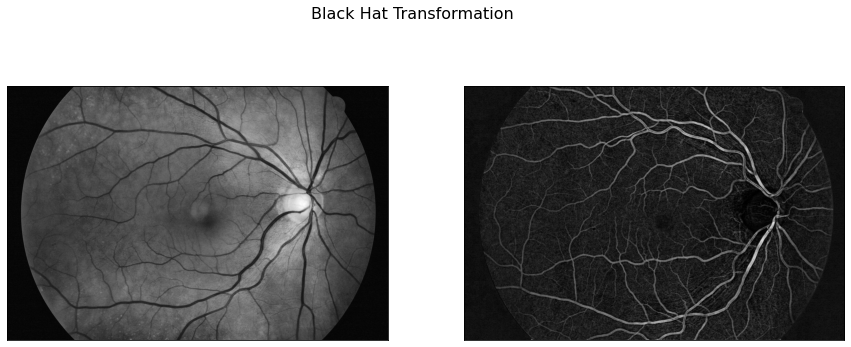

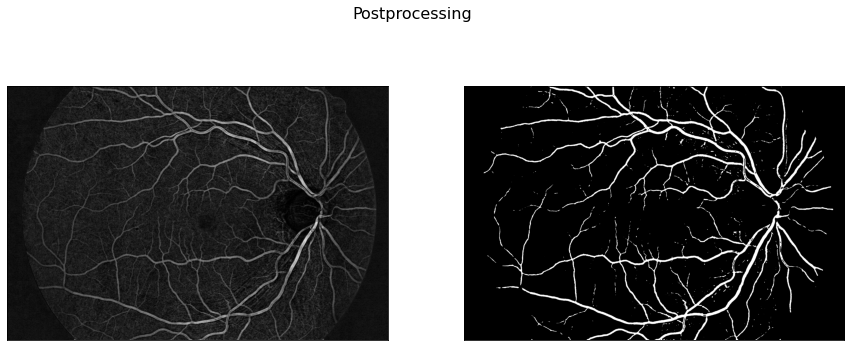

0.6932441533964415
505384
True Positives: 505384 False Positives: 56300 
False Negatives: 223629 True Negatives: 7400031

Accuracy: 0.9658011929614687
Precision: 0.8997657045598593
Recall: 0.6932441533964415
F1 Score: 0.7831179587463208
G-mean: 0.7897830804168651


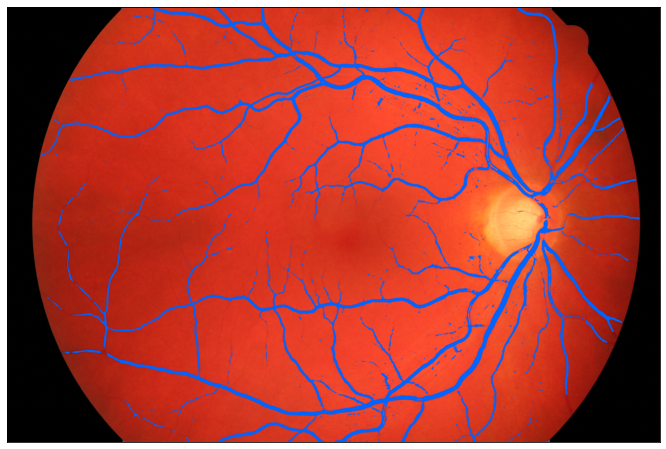

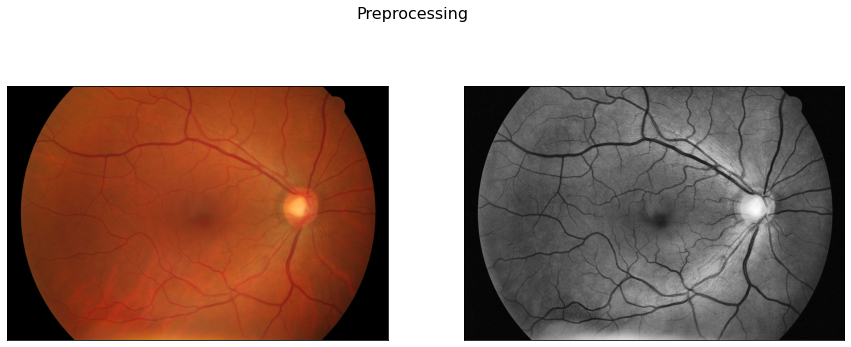

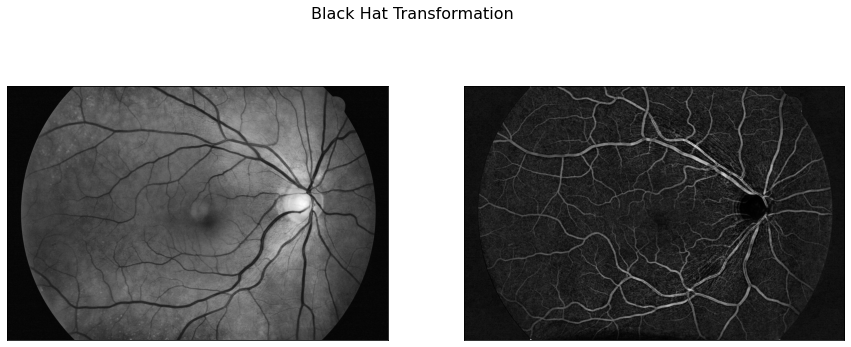

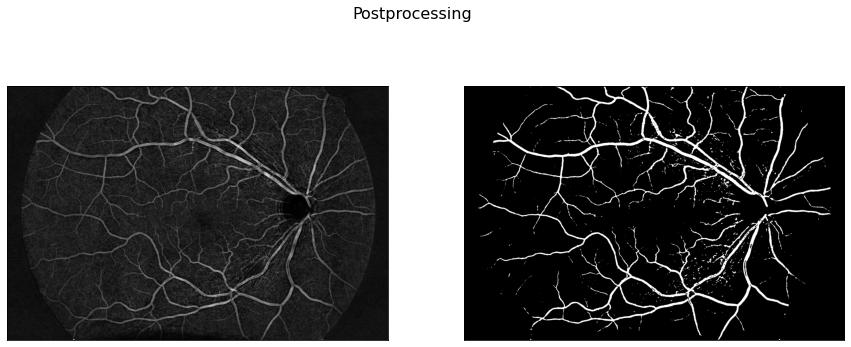

0.7522475808778236
482375
True Positives: 482375 False Positives: 104286 
False Negatives: 158870 True Negatives: 7439813

Accuracy: 0.9678503432476387
Precision: 0.8222380557084926
Recall: 0.7522475808778236
F1 Score: 0.78568717800874
G-mean: 0.7864646135156996


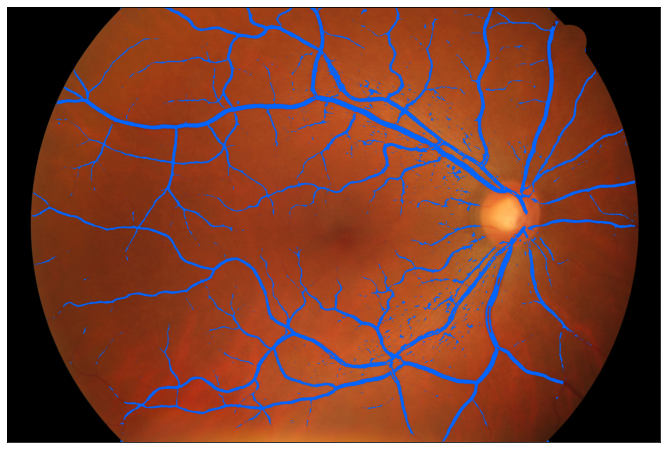

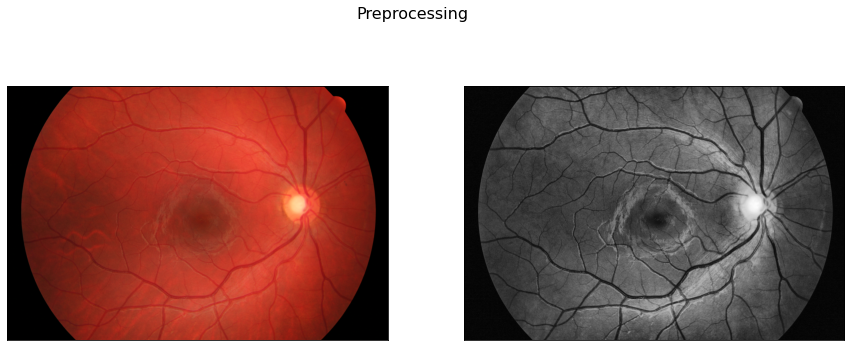

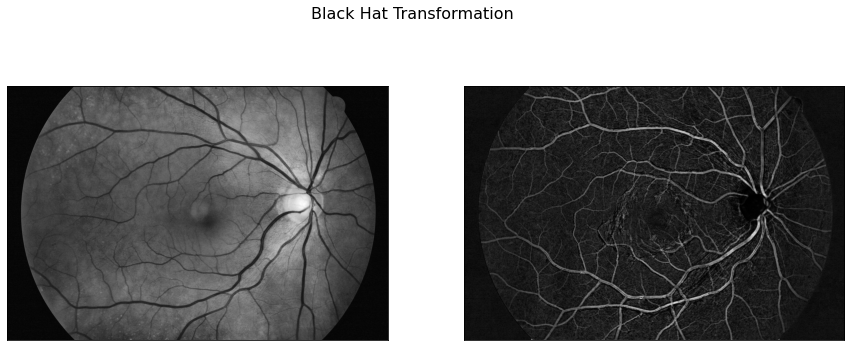

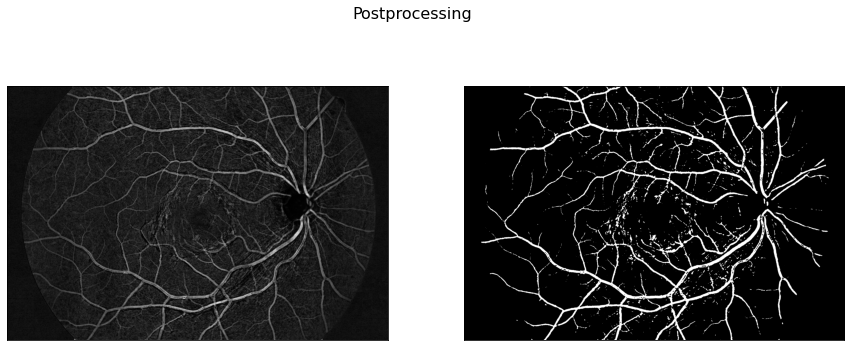

0.7584877258315008
540154
True Positives: 540154 False Positives: 143089 
False Negatives: 171992 True Negatives: 7330109

Accuracy: 0.9615066880512291
Precision: 0.7905737782897154
Recall: 0.7584877258315008
F1 Score: 0.7741984493213003
G-mean: 0.7743645828658381


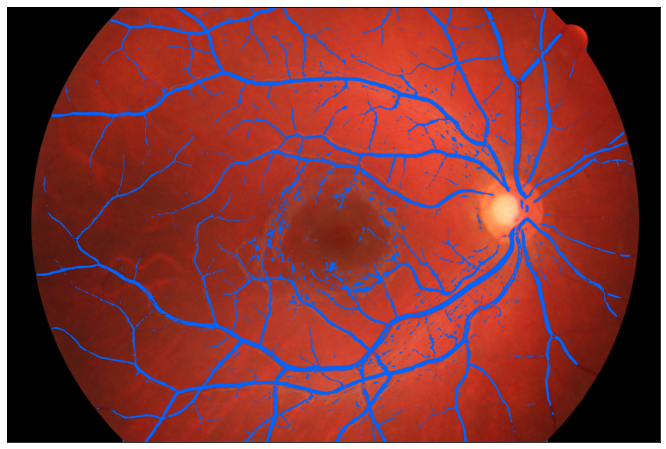

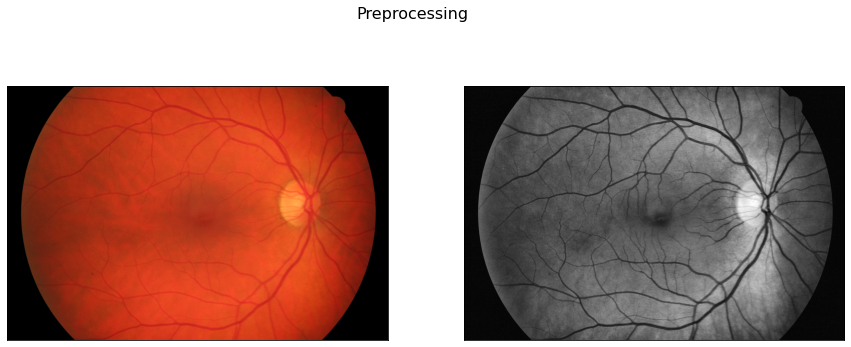

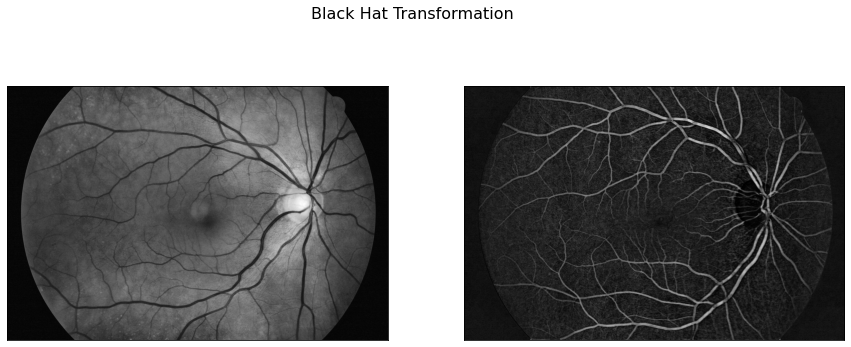

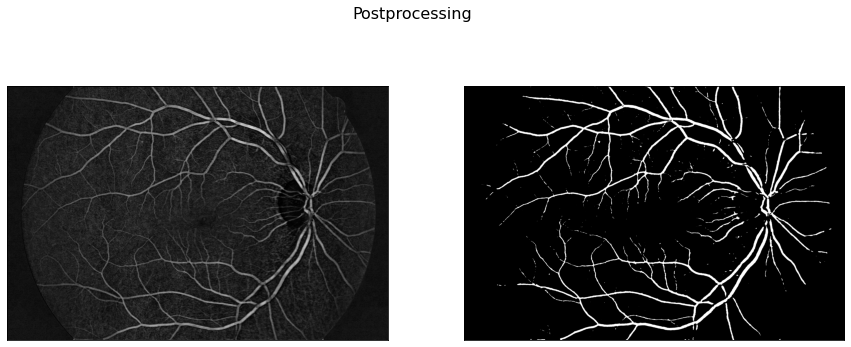

0.6608246501693319
488208
True Positives: 488208 False Positives: 50568 
False Negatives: 250578 True Negatives: 7395990

Accuracy: 0.9632091210827547
Precision: 0.9061428125974431
Recall: 0.6608246501693319
F1 Score: 0.7642807159261156
G-mean: 0.7738226587133255


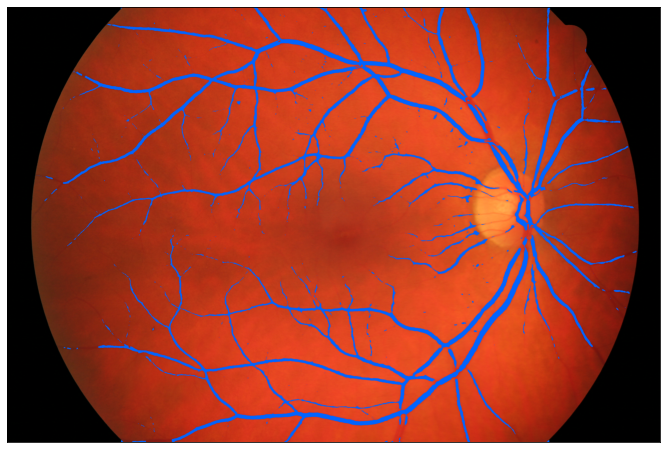

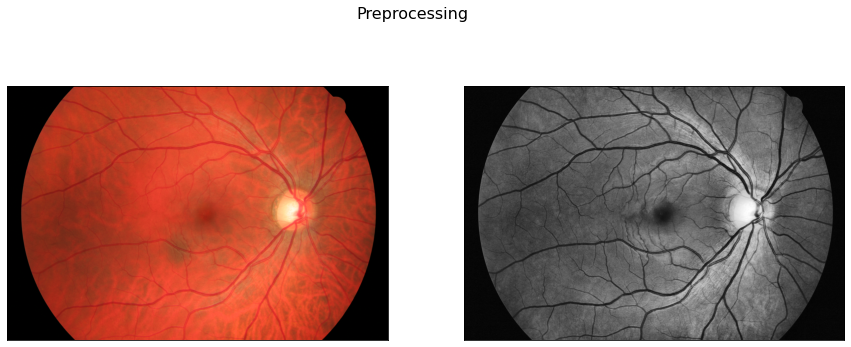

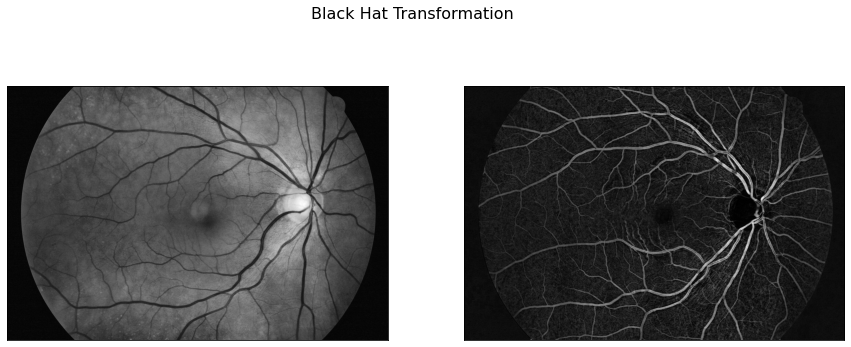

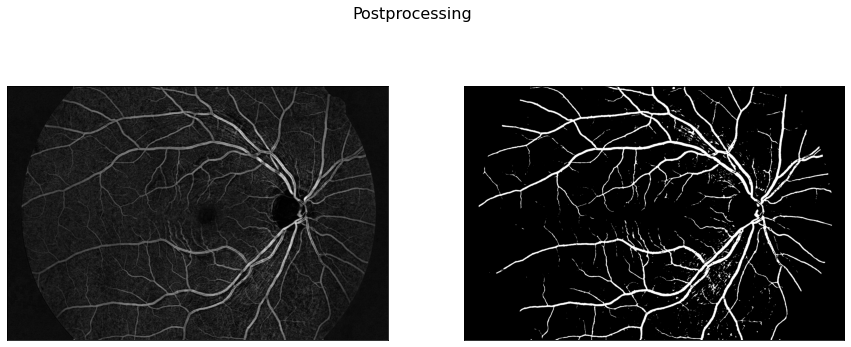

0.6843964657124219
570710
True Positives: 570710 False Positives: 93105 
False Negatives: 263178 True Negatives: 7258351

Accuracy: 0.9564730572105461
Precision: 0.859742548752288
Recall: 0.6843964657124219
F1 Score: 0.7621137168050007
G-mean: 0.7670754602962184


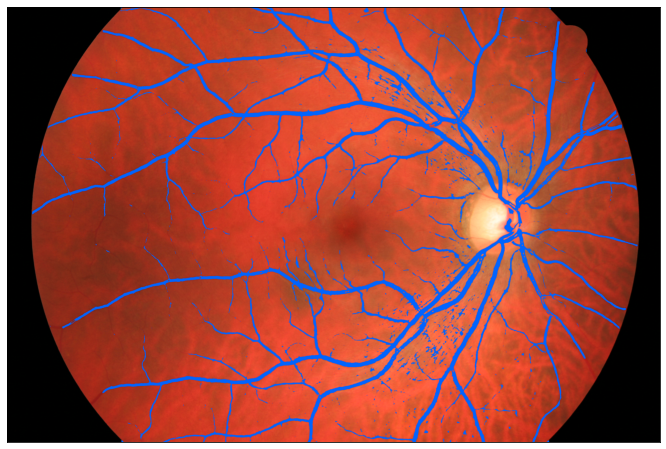

In [19]:
subset_test= [35, 32, 5, 23, 17, 20, 44, 38, 14, 2]
sum_acc = 0
sum_prec =0
sum_recall = 0
sum_f1 = 0
sum_gmean= 0
total = 0

detailed = len(subset_test)


for index in subset_test:
    img = cv2.imread(os.path.join(dir_images, raw_images[index]))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    img_manual = cv2.imread(os.path.join(dir_manuals, manuals[index]),0)/255
    
    if total < detailed:
        details = True
    else:
        details = False
        
    mask = extract_blood_vessels(img, details)
    
    confusion_matrix = calculate_confusion_matrix(mask, img_manual)
    
    if details:
        print(confusion_matrix)
        
    sum_acc += confusion_matrix.accuracy
    sum_prec += confusion_matrix.precision
    sum_recall += confusion_matrix.recall
    sum_f1 += confusion_matrix.f1_score
    sum_gmean += confusion_matrix.G_mean
    
    plt.imshow(draw_mask(img, mask))
    
    
    total +=1
    

In [20]:
print("Average accuracy:", sum_acc/total)
print("Average precision:", sum_prec/total)
print("Average recall:", sum_recall/total)
print("Average F1-score: ", sum_f1/total)
print("Average G-mean: ", sum_gmean/total)

Average accuracy: 0.96317534119519
Average precision: 0.866702384150358
Average recall: 0.7232518812380886
Average F1-score:  0.7871202359820094
Average G-mean:  0.7910331337704456


## Wersja na 4

In [21]:
import random
from patchify import patchify, unpatchify
from sklearn.feature_extraction.image import extract_patches_2d
from imblearn.under_sampling import RandomUnderSampler


def extract_datasets(img, img_manual, random_patches = False, undersampling = True, patch_size = (5,5), num_patches = 10000, random_state = None, shape=False):
    X = []
    y = []
    
    sh = None
    
    middleX = patch_size[0] // 2
    middleY = patch_size[1] // 2  
    
    
    if random_state is None:
        r = random.randint(0,100000)
    else:
        r = random_state
    
    if random_patches:
        patches = extract_patches_2d(img, patch_size, max_patches = num_patches, random_state = r)
        patches_manual = extract_patches_2d(img_manual, patch_size, max_patches = num_patches, random_state = r)
    else:
        patches = patchify(img, patch_size)
        sh = patches.shape[:2]
        patches = np.reshape(patches, (patches.shape[0] * patches.shape[1], patches.shape[2], patches.shape[3]))
        patches_manual = patchify(img_manual, patch_size)
        patches_manual = np.reshape(patches_manual, (patches_manual.shape[0] * patches_manual.shape[1], patches_manual.shape[2], patches_manual.shape[3]))
                             
    indices = np.arange(0, patches.shape[0], 1)
    y = [int(patch_m[middleX,middleY]) for patch_m in patches_manual]
    
    
    if undersampling:
        undersampler = RandomUnderSampler(sampling_strategy='majority', random_state=123)
        indices, y = undersampler.fit_resample(indices.reshape(-1, 1), y)
        patches = patches[indices.flatten()]
    
    X = [np.append(cv2.HuMoments(cv2.moments(patch)), np.var(patch)) for patch in patches]
    

    if shape:
        return (X,y, sh)
    

    return (X,y)


### Wczytanie zdjęć i podział na zbiór treningowy i testowy

In [22]:
from sklearn.model_selection import train_test_split

dir_images = 'images_HRF/images'
raw_images_listed = os.listdir(dir_images)

dir_manuals = 'images_HRF/manual1'
manuals_listed = os.listdir(dir_manuals)

images = []
manuals = []

for index in range(len(raw_images_listed)):
    img_raw = cv2.imread(os.path.join(dir_images, raw_images_listed[index]))
    img_raw = cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB)
    
    img_manual = cv2.imread(os.path.join(dir_manuals, manuals_listed[index]),0)/255
    
    images.append(img_raw)
    manuals.append(img_manual)

images_train, images_test, manuals_train, manuals_test = train_test_split(images, manuals, test_size=0.33)

for ind in range(len(images_train)):
    images_train[ind] = prep_img(images_train[ind])/255

### Przygotowanie zbioru treningowego

In [23]:
X_train = []
y_train = []

progress = 0

for img, man in zip(images_train, manuals_train):
    progress +=1
    X, y = extract_datasets(img, man)
    X_train = X_train + X
    y_train = y_train + y
    

X_train = np.array(X_train)
y_train = np.array(y_train)
    


### Uczenie klasyfikatora

In [24]:
from sklearn import ensemble

clf = ensemble.RandomForestClassifier(n_estimators= 20).fit(X_train, y_train)

### Ewaluacja i przedstawienie wyników

1
0.7660910291994715
425608
True Positives: 425608 False Positives: 656914 
False Negatives: 129950 True Negatives: 6972872

Accuracy: 0.903869159316945
Precision: 0.3931633721993641
Recall: 0.7660910291994715
F1 Score: 0.5196425083024029
G-mean: 0.5488159367691009


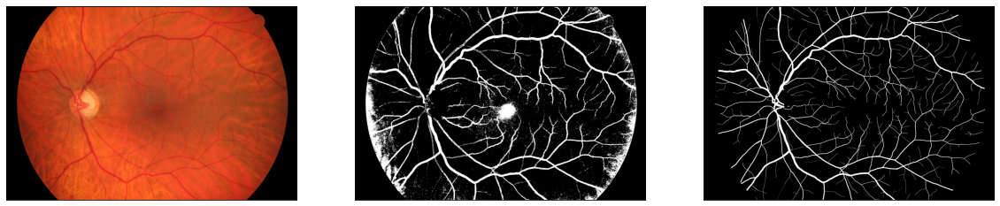

2
0.8079464084634118
577592
True Positives: 577592 False Positives: 1501350 
False Negatives: 137297 True Negatives: 5969105

Accuracy: 0.7998071919762932
Precision: 0.2778297807250034
Recall: 0.8079464084634118
F1 Score: 0.41347669204042764
G-mean: 0.47378431115956526


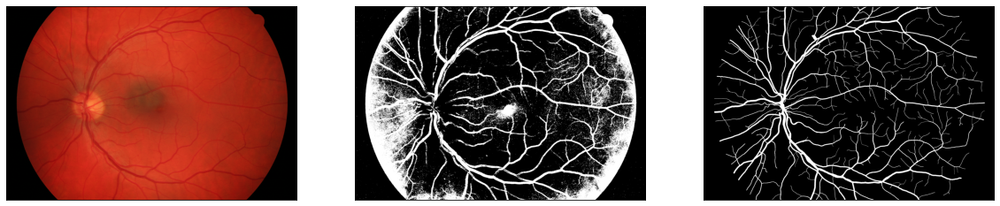

3
0.7575464703938259
424048
True Positives: 424048 False Positives: 1183487 
False Negatives: 135717 True Negatives: 6442092

Accuracy: 0.8388334076124351
Precision: 0.26378772468406597
Recall: 0.7575464703938259
F1 Score: 0.39131453882711204
G-mean: 0.4470251220766373


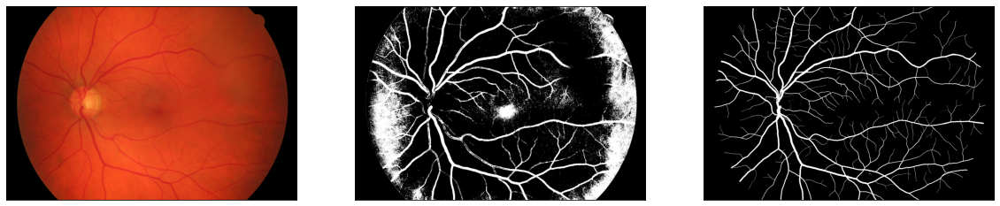

4
0.7568152432582752
473534
True Positives: 473534 False Positives: 857591 
False Negatives: 152159 True Negatives: 6702060

Accuracy: 0.8766392713611059
Precision: 0.35573969386796883
Recall: 0.7568152432582752
F1 Score: 0.48398369189163226
G-mean: 0.5188730316284622


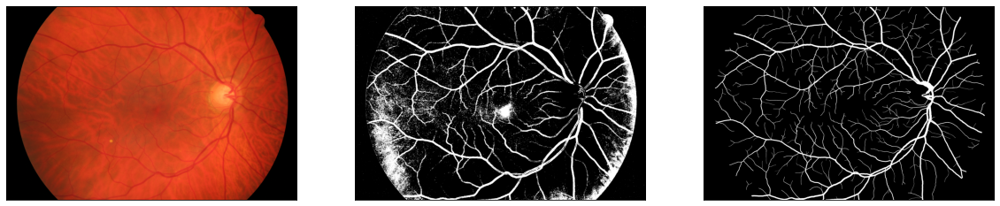

5
0.7219096306458671
488317
True Positives: 488317 False Positives: 621638 
False Negatives: 188107 True Negatives: 6887282

Accuracy: 0.9010737972649653
Precision: 0.4399430607547153
Recall: 0.7219096306458671
F1 Score: 0.5467115320992914
G-mean: 0.5635593424783665


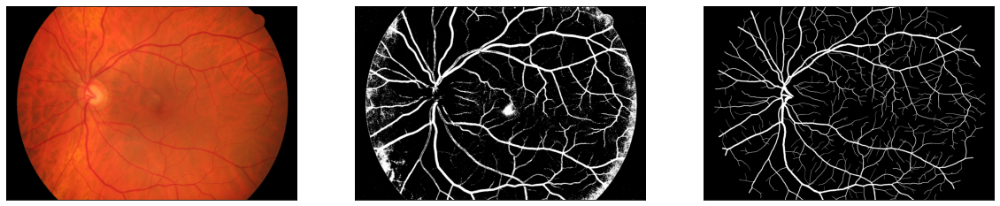

In [28]:
X_test = []
y_test = []
masks = []
images_with_masks=[]

sum_acc = 0
sum_prec =0
sum_recall = 0
sum_f1 = 0
sum_gmean= 0
total = 0



for img, man in zip(images_test[:5], manuals_test[:5]):
    total+=1
    print(total)
    
    prepared_img = prep_img(img)/255
    X, y, shape = extract_datasets(prepared_img, man, shape = True, undersampling=False)
    X_test = X_test + X
    y_test = y_test + y
    
    mask = clf.predict(X).reshape(shape)
    images_with_masks.append(draw_mask(img, mask))
    masks.append(mask)
    
    confusion_matrix = calculate_confusion_matrix(pad_mask(img, mask), man)
    print(confusion_matrix)
        
    sum_acc += confusion_matrix.accuracy
    sum_prec += confusion_matrix.precision
    sum_recall += confusion_matrix.recall
    sum_f1 += confusion_matrix.f1_score
    sum_gmean += confusion_matrix.G_mean
    
    fig, axs = plt.subplots(1,3)
    fig.set_size_inches(20, 10)
    axs[0].imshow(img, cmap='gray')
    axs[1].imshow(mask, cmap='gray')
    axs[2].imshow(man, cmap='gray')
    
    plt.show()
    


X_test = np.array(X_test)
y_test = np.array(y_test)

In [29]:
print("Average accuracy:", sum_acc/total)
print("Average precision:", sum_prec/total)
print("Average recall:", sum_recall/total)
print("Average F1-score: ", sum_f1/total)
print("Average G-mean: ", sum_gmean/total)

Average accuracy: 0.8640445655063489
Average precision: 0.3460927264462235
Average recall: 0.7620617563921703
Average F1-score:  0.47102579263217326
Average G-mean:  0.5104115488224265


In [30]:
import pickle

filename = 'finalized_model.sav'
pickle.dump(clf, open(filename, 'wb'))